# Plotly Tutorial

**Plotly charts are not rendered properly in GitHub. You can view this notebook properly from [here](https://nbviewer.org/github/Sayan-Roy-729/Data-Science/blob/main/Plotly%20Tutorial/Plotly%20Tutorial.ipynb)**

## Install the Required Packages:

In [1]:
# !pip install plotly, cufflinks, chart_studio

## <a id='toc1_3_'></a>[Import Libraries](#toc0_)

In [95]:
import numpy as np
import pandas as pd

import seaborn as sns
import matplotlib.pyplot as plt

import plotly.graph_objects as go
import chart_studio.plotly as py
import plotly.express as px
import cufflinks as cf

from plotly.offline import download_plotlyjs, init_notebook_mode
from plotly.offline import plot, iplot

from urllib.request import urlopen
import json

import warnings

warnings.filterwarnings("ignore")

init_notebook_mode(connected=True)
cf.go_offline()

## Basics

In [3]:
arr_1 = np.random.rand(50, 4)
df_1  = pd.DataFrame(arr_1, columns=["A", "B", "C", "D"])
df_1.head()

,A,B,C,D
0,0.639776,0.725564,0.012753,0.498139
1,0.709170,0.575830,0.302088,0.131557
2,0.739058,0.657956,0.830237,0.144154
3,0.045924,0.393856,0.879968,0.437624
4,0.070341,0.562307,0.004084,0.703784


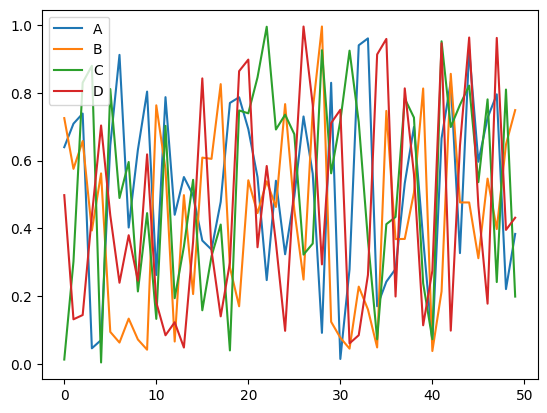

In [4]:
# this is matplotlib plot

df_1.plot()
plt.show()

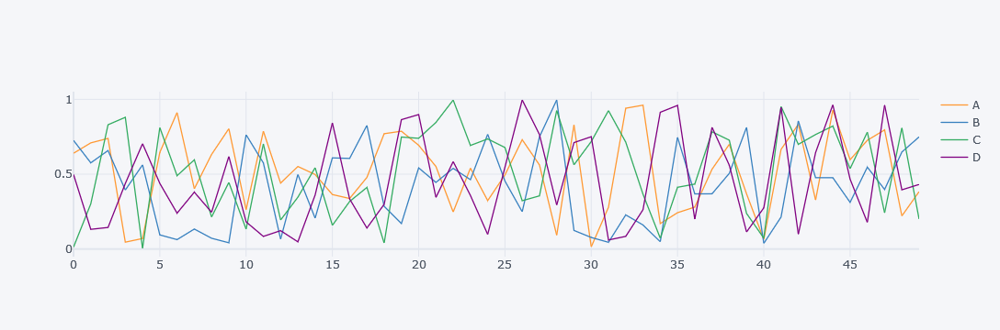

In [5]:
# same type of plots using plotly
df_1.iplot()

## Line Plots

In [6]:
# load the stocks dataset
df_stocks = px.data.stocks()
# top 2 rows of this stocks
df_stocks.head(2)

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988


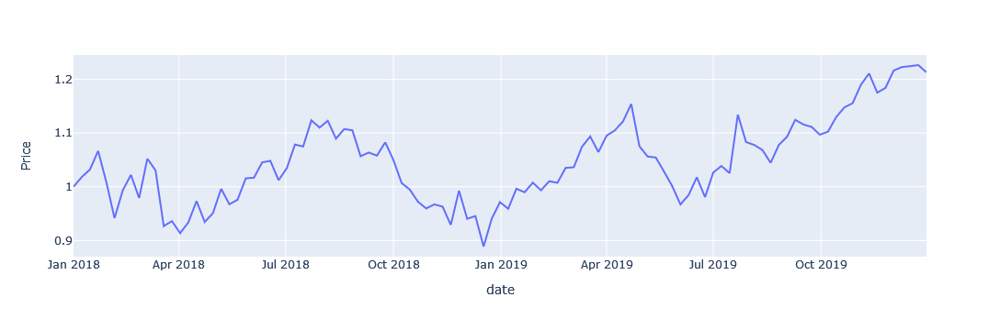

In [7]:
# plot a single labeled line plot
px.line(df_stocks, x="date", y="GOOG", labels={"x": "Date", "GOOG": "Price"})

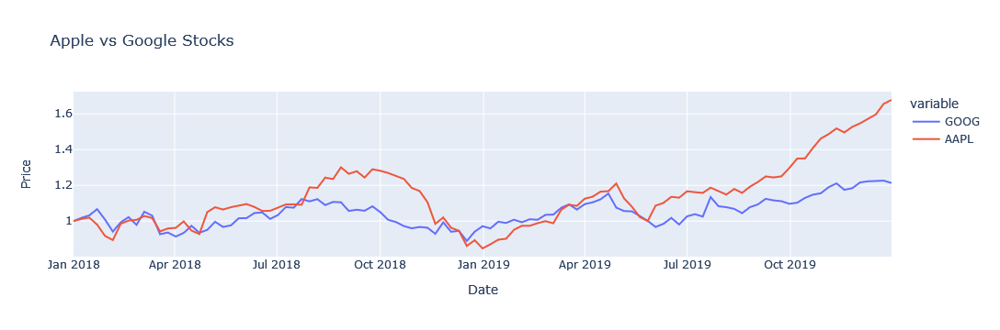

In [8]:
# plot multiple labeled line plot
px.line(df_stocks, x="date", y=["GOOG", "AAPL"], labels={"date": "Date", "value": "Price"}, 
        title="Apple vs Google Stocks")

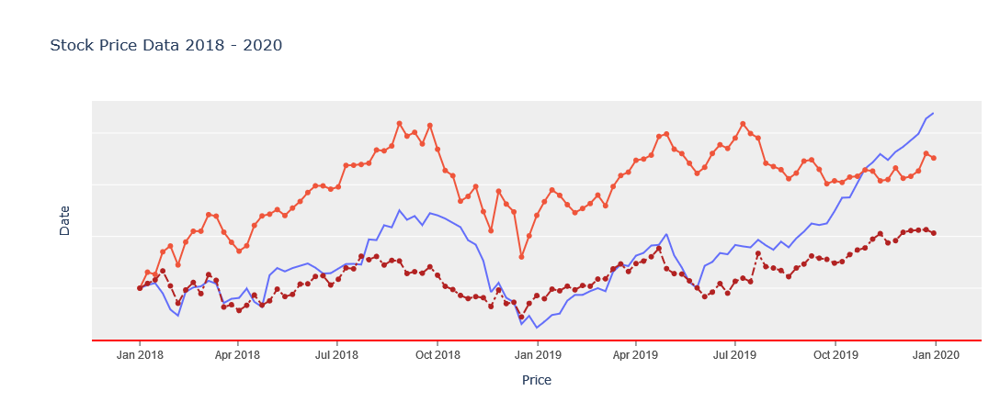

In [9]:
# create figure
fig = go.Figure()

# Apple stock line plot
fig.add_trace(go.Scatter(x=df_stocks["date"], y=df_stocks["AAPL"],
                        mode="lines", name="Apple"))
# Amazon stock line plot
fig.add_trace(go.Scatter(x=df_stocks["date"], y=df_stocks["AMZN"],
                        mode="lines+markers", name="Amazon"))
# Google stock line plot
fig.add_trace(go.Scatter(x=df_stocks["date"], y=df_stocks["GOOG"],
                        mode="lines+markers", name="Google",
                        line=dict(color="firebrick", width=2, dash="dashdot")))

# Customize the chart
fig.update_layout(
    # customize the x-axis styles
    xaxis = dict(showline=True, showgrid=False, showticklabels=True,
                # change the x-axis ticks color and thickness of the line
                linecolor="rgb(256, 0, 0)", linewidth=2, 
                ticks="outside", # ticks={"outside", "inside"}
                # define the font styles of the x-axis ticks
                tickfont=dict(
                    family="Arial",
                    size=12,
                    color="rgb(82, 82, 82)"
                )),
    # customize the y-axis styles
    yaxis = dict(showgrid=True, zeroline=False, showline=False, 
                showticklabels=False),
    # turn off the autosize graph
    autosize = False,
    # Set margin; l=left, r=right, t=top 
    margin = dict(autoexpand=False, l=100, r=20, t=110,),
    # show the legends (it's by-default True)
    showlegend = False,
    # change background color
    plot_bgcolor = "#eee",
    # Add title, x axis label & y axis label
    title = "Stock Price Data 2018 - 2020",
    xaxis_title = "Price",
    yaxis_title = "Date",
)

## Bar Charts

In [10]:
# load the data
df_usa = px.data.gapminder().query("country == 'United States'")
df_usa.sample(2)

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
1608,United States,Americas,1952,68.44,157553000,13990.48208,USA,840
1612,United States,Americas,1972,71.34,209896000,21806.03594,USA,840


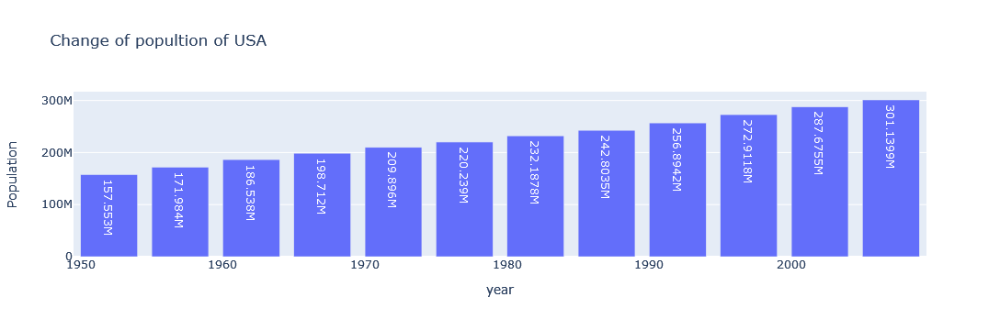

In [11]:
# bar chart using plotly express
px.bar(
    df_usa, x="year", y="pop", labels={"pop": "Population"}, 
    title="Change of popultion of USA",
    text_auto = True,
)

In [12]:
# load the tips dataset
df_tips = px.data.tips()
df_tips.sample(3)

,total_bill,tip,sex,smoker,day,time,size
204,20.53,4.0,Male,Yes,Thur,Lunch,4
29,19.65,3.0,Female,No,Sat,Dinner,2
213,13.27,2.5,Female,Yes,Sat,Dinner,2


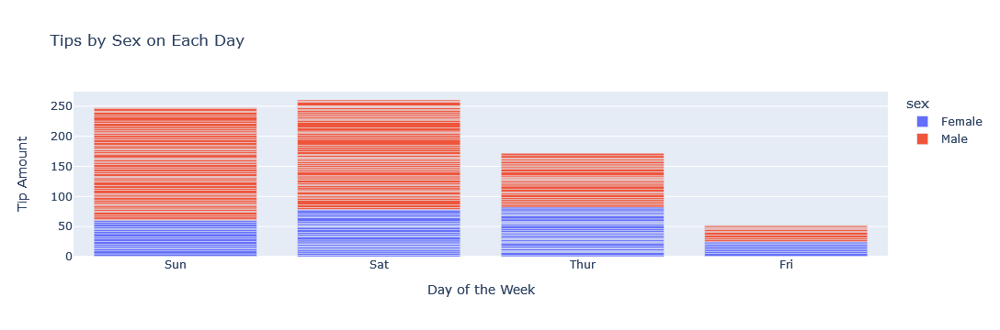

In [13]:
# now plot stacked bar chart using plotly express
px.bar(df_tips, x="day", y="tip", color="sex", title="Tips by Sex on Each Day",
      labels={"tip": "Tip Amount", "day": "Day of the Week"})

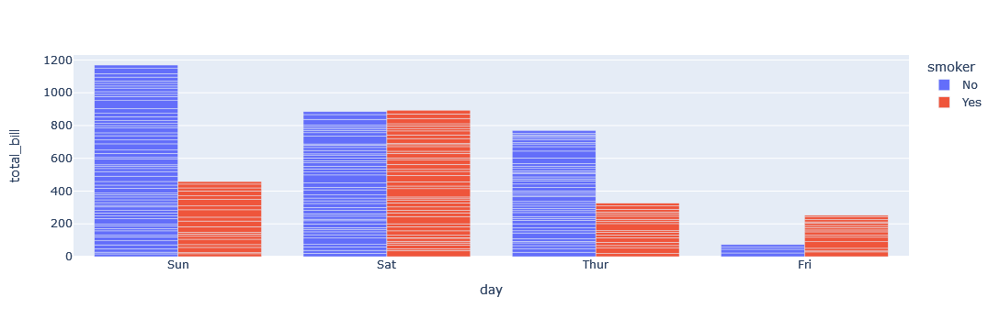

In [14]:
# plot grouped bar chart using plotly express
px.bar(df_tips, x="day", y="total_bill", color="smoker", 
      barmode="group")

In [15]:
# filter the data
df_europe = px.data.gapminder().query("continent == 'Europe' and year == 2007 and pop > 2.36")
df_europe.sample(2)

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
755,Ireland,Europe,2007,78.885,4109086,40675.99635,IRL,372
1283,Romania,Europe,2007,72.476,22276056,10808.47561,ROU,642


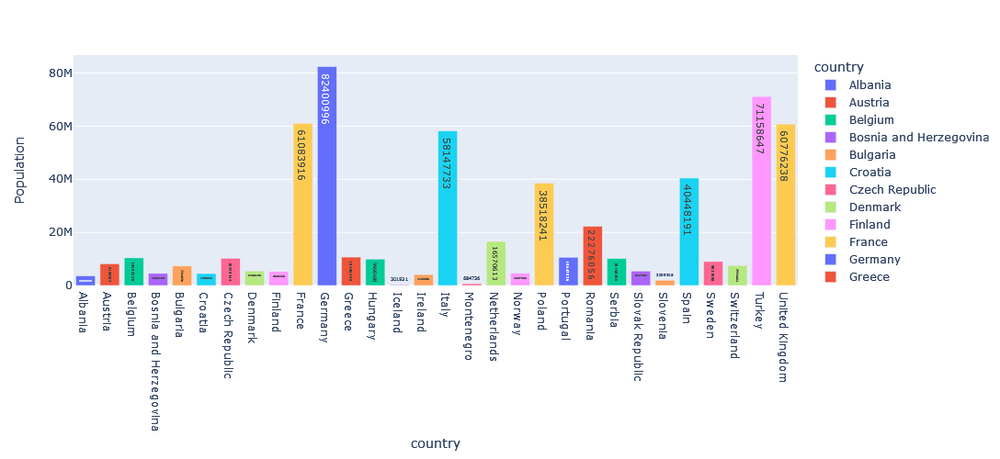

In [16]:
# text = the pop up text while hovering
fig = px.bar(df_europe, y="pop", x="country", text="pop", 
    color="country", height = 500,
    labels = {"pop": "Population"},
)
fig

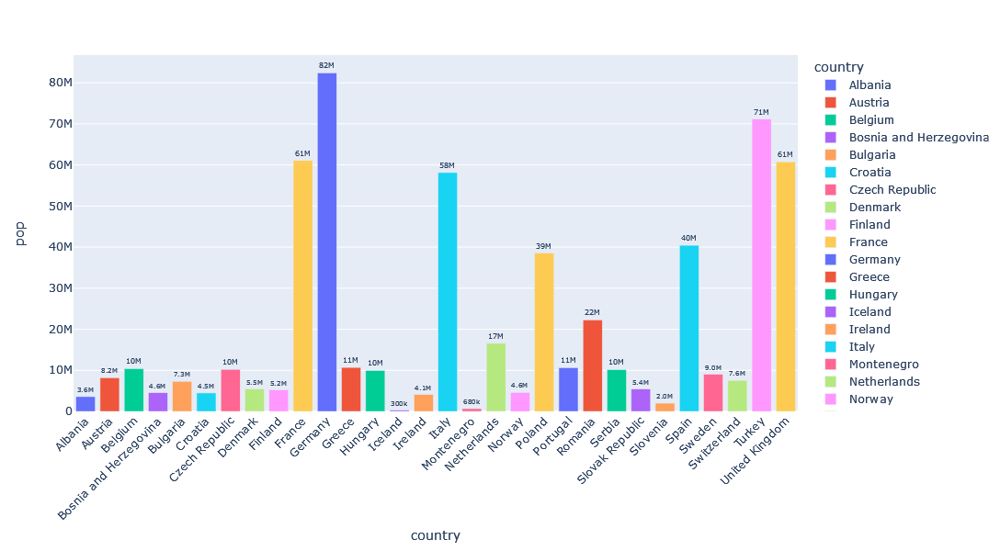

In [17]:
# text = the pop up text while hovering
fig = px.bar(df_europe, y="pop", x="country", text="pop", color="country", height=600)
fig.update_traces(
    # customize the values of the every bar
    texttemplate = '%{text:.2s}',
    textposition = "outside",
)
fig.update_layout(
    # set the minimum font size
    uniformtext_minsize = 8,
    # rotate the x-axis ticks
    xaxis_tickangle=-45
)

## Scatter Plots

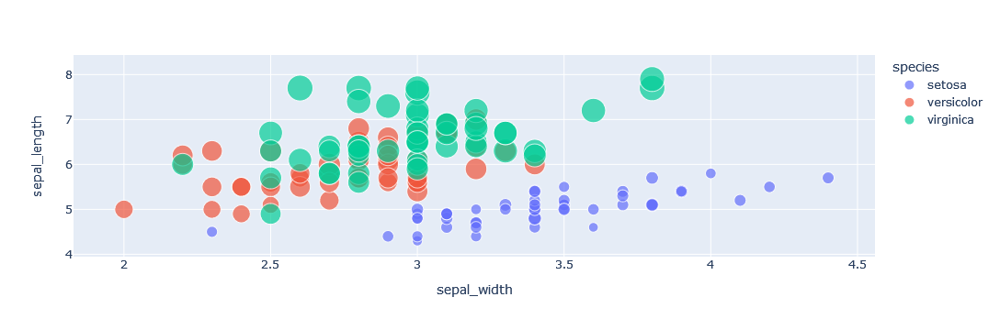

In [18]:
# load the iris dataset
df_iris = px.data.iris()

# scatter plot using plotly express
px.scatter(df_iris, x="sepal_width", y="sepal_length", color="species", size="petal_length",
    hover_data=["petal_width"]
)

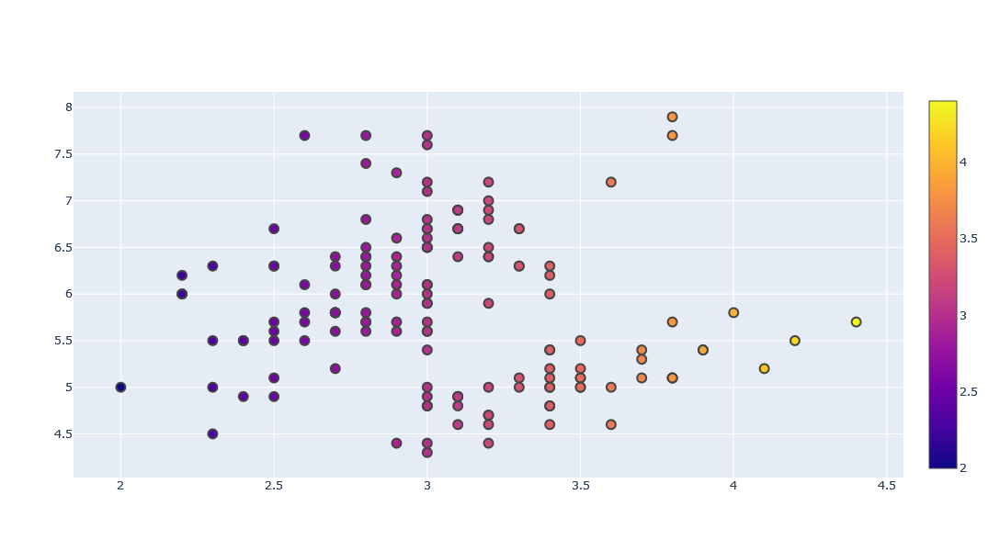

In [19]:
# create more customised scatter plot

# create a figure
fig = go.Figure()

# add a trace to this figure
fig.add_trace(go.Scatter(
    x    = df_iris["sepal_width"],
    y    = df_iris["sepal_length"],
    mode = "markers",
    # change the marker color according to the "sepal_width" of each records
    marker_color = df_iris["sepal_width"],
    # what text will pop-up when you hover over a point
    text = df_iris["species"],
    # customize the every marker points
    marker = dict(
        showscale = True # this enables the color-bar
    )
))

fig.update_traces(marker_line_width=2, marker_size=10) # more customization of the marker
fig.update_layout(autosize = False, width=600, height=600)

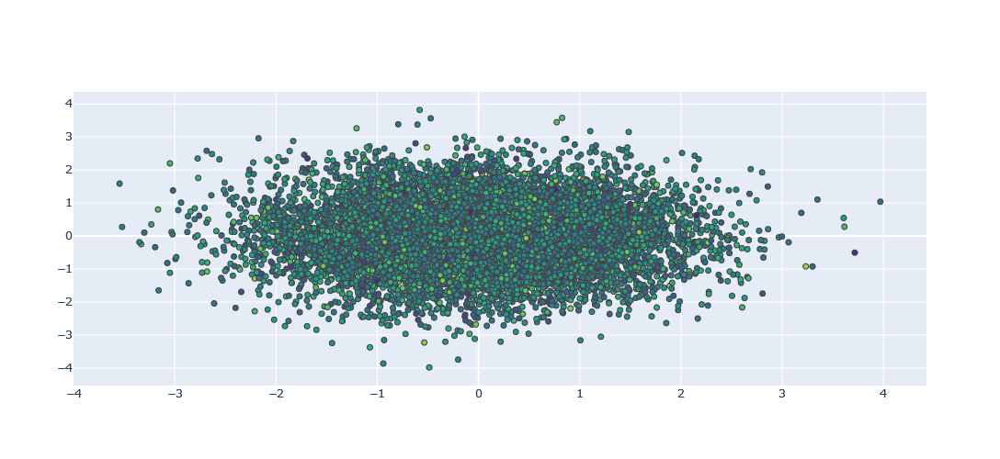

In [20]:
# create a massive scatter plot

fig = go.Figure(data = go.Scattergl(
    x = np.random.randn(100_000),
    y = np.random.randn(100_00),
    mode = "markers",
    marker = dict(
        color = np.random.randn(100_000),
        # can get the color scale ref from https://plotly.com/python/builtin-colorscales/
        colorscale = "Viridis",
        line_width = 1
    )
))

# update the figure of the plot
fig.update_layout(autosize=False, width=500, height=500)

fig

## Pie Charts

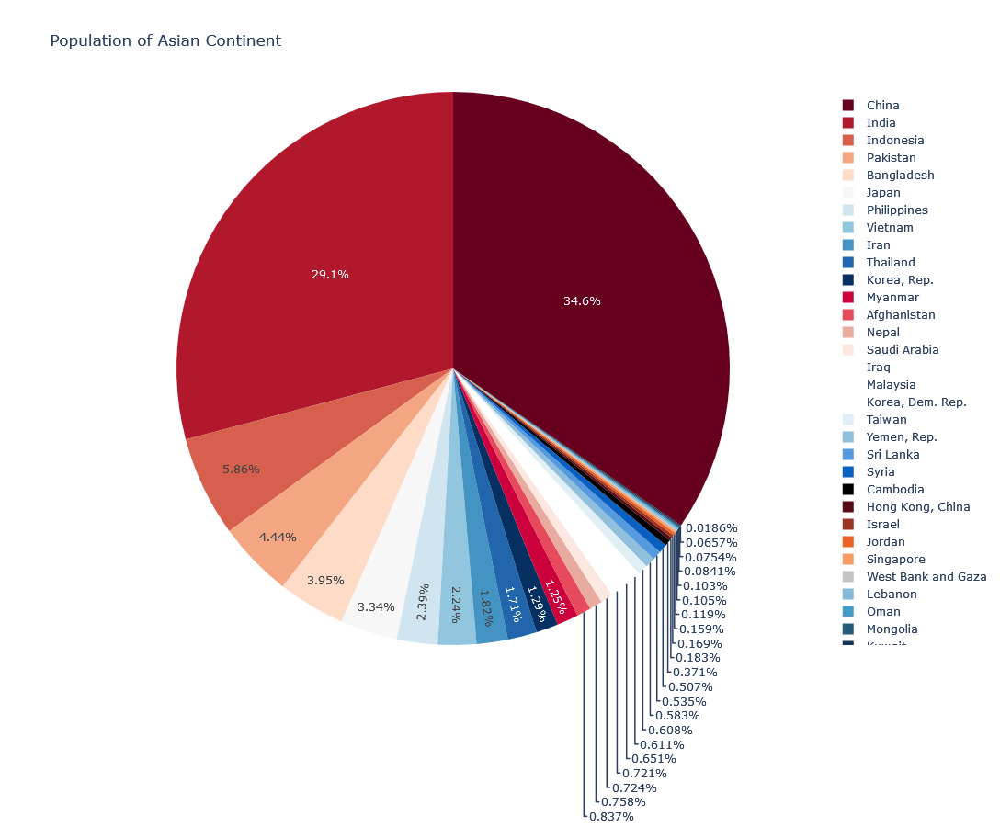

In [21]:
# again load a dataset
df_asia = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")

# not create a pie chart
px.pie(
    data_frame = df_asia, 
    values="pop", 
    names="country", 
    title="Population of Asian Continent",
    color_discrete_sequence=px.colors.sequential.RdBu,
    width = 900,
    height = 900
)

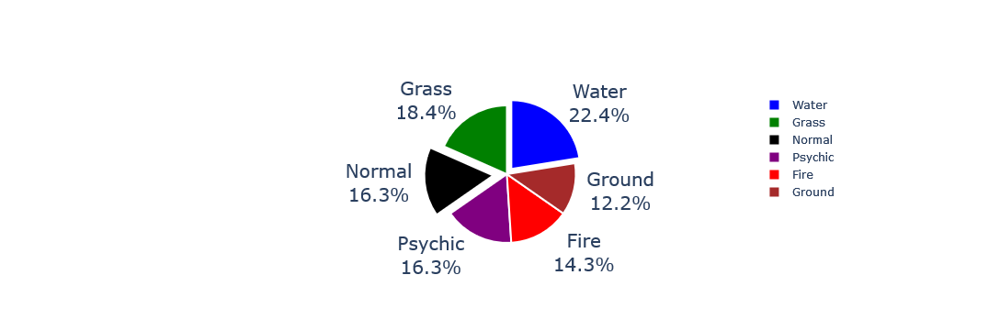

In [22]:
colors = ["blue", "green", "black", "purple", "red", "brown"]

fig = go.Figure(
    data=[
        go.Pie(
            labels = ["Water", "Grass", "Normal", "Psychic", "Fire", "Ground"],
            values = [110, 90, 80, 80, 70, 60]
        )
    ]
)

fig.update_traces(
    hoverinfo = "label+percent", # set the info while you will hover
    textfont_size = 20, # set the font size
    textinfo = "label+percent", # also display the information
    pull = [0.1, 0, 0.2, 0, 0], # pull out a piece of the pie chart
    # customize the markers
    marker = dict(
        colors = colors,
        line = dict(
            color = "#fff",
            width = 2
        )
    )
)

fig

## Histogram

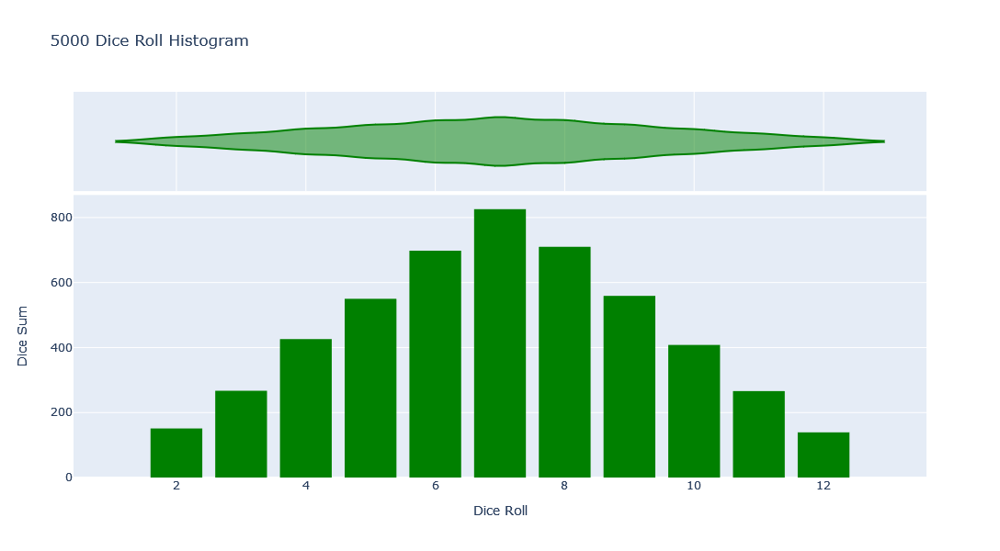

In [23]:
# create dummy dice data
dice_1 = np.random.randint(1, 7, 5000)
dice_2 = np.random.randint(1, 7, 5000)

dice_sum = dice_1 + dice_2

# create the histogram
fig = px.histogram(dice_sum, nbins=11, 
    labels={"value": "Dice Roll"},
    title = "5000 Dice Roll Histogram",
    marginal = "violin",
    color_discrete_sequence = ["green"],
    height = 600
)

fig.update_layout(
    xaxis_title = "Dice Roll",
    yaxis_title = "Dice Sum",
    bargap      = 0.2,
    showlegend = False
)

fig

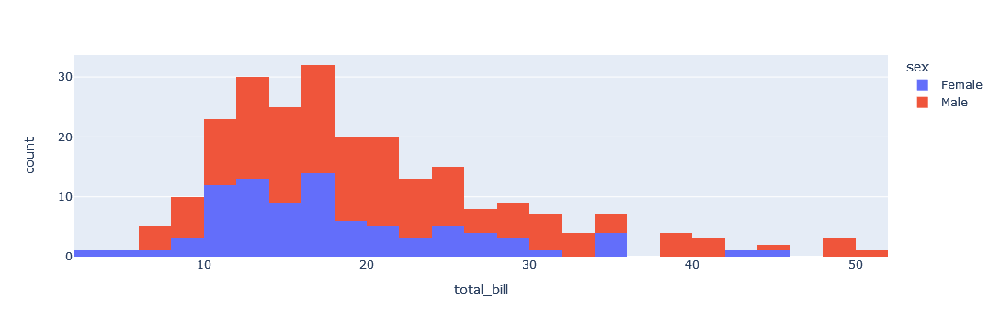

In [24]:
px.histogram(
    data_frame = df_tips,
    x          = "total_bill",
    color      = "sex"
)

## Box Plots

In [26]:
df_tips.sample(2)

,total_bill,tip,sex,smoker,day,time,size
178,9.60,4.00,Female,Yes,Sun,Dinner,2
165,24.52,3.48,Male,No,Sun,Dinner,3


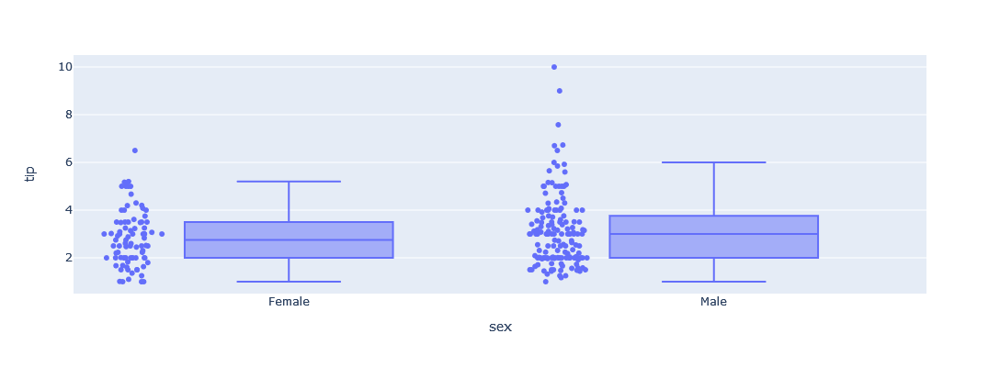

In [28]:
px.box(df_tips, x="sex", y="tip", points="all", height=400)

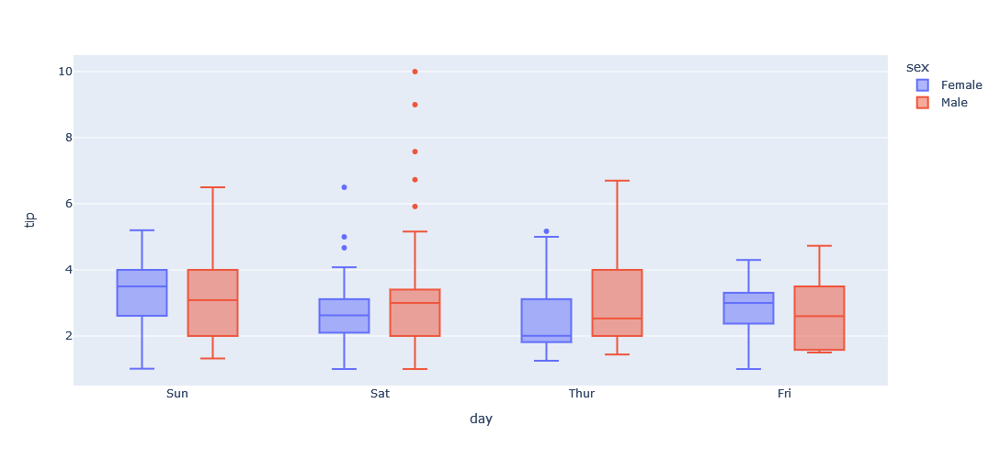

In [30]:
px.box(df_tips, x="day", y="tip", color="sex", height=500)

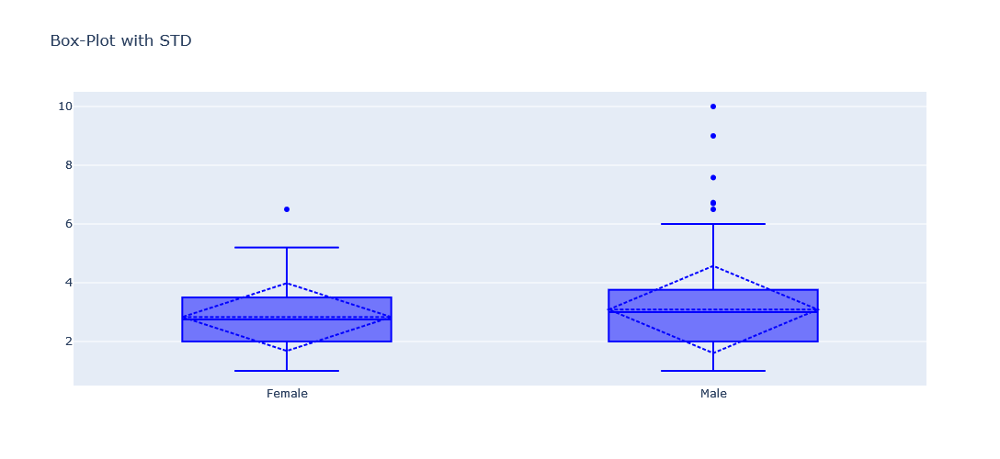

In [33]:
fig = go.Figure()

fig.add_trace(
    go.Box(
        x = df_tips["sex"],
        y = df_tips["tip"],
        marker_color = "blue",
        boxmean = "sd",
    )
)

fig.update_layout(
    autosize = False,
    height   = 500,
    width    = 500,
    title    = "Box-Plot with STD"
)

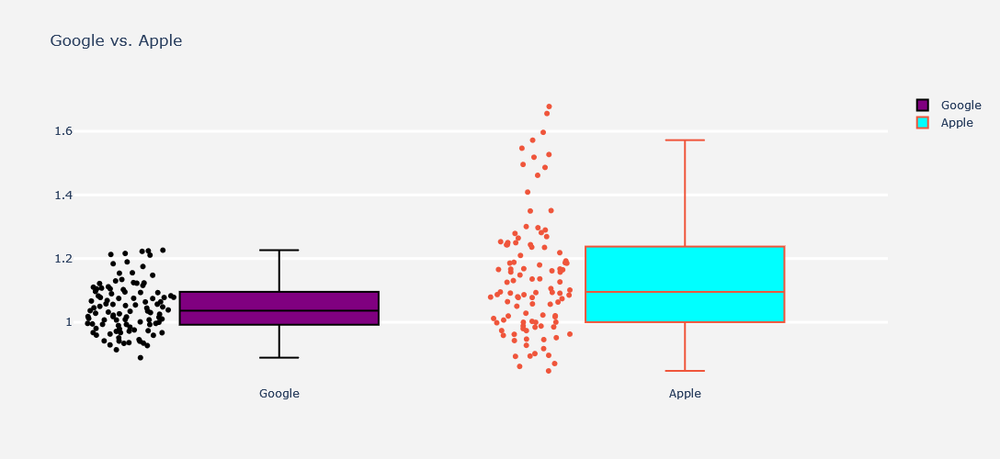

In [42]:
fig = go.Figure()
fig.add_trace(
    go.Box(
        y = df_stocks["GOOG"],
        boxpoints = "all",
        fillcolor = "purple",
        jitter = 0.5,
        whiskerwidth = 0.2,
        line = dict(
            color = "black"
        ),
        name = "Google"
    )
)

fig.add_trace(
    go.Box(
        y = df_stocks["AAPL"],
        boxpoints = "all",
        fillcolor = "cyan",
        jitter    = 0.5,
        whiskerwidth = 0.2,
        name = "Apple"
    )
)

fig.update_layout(autosize=False, height=500, width=400,
    title = "Google vs. Apple",
    yaxis = dict(
        gridcolor = 'rgb(255, 255, 255)',
        gridwidth = 3
    ),
    paper_bgcolor = "rgb(243, 243, 243)",
    plot_bgcolor  = "rgb(243, 243, 243)"
)

## Violin Plot

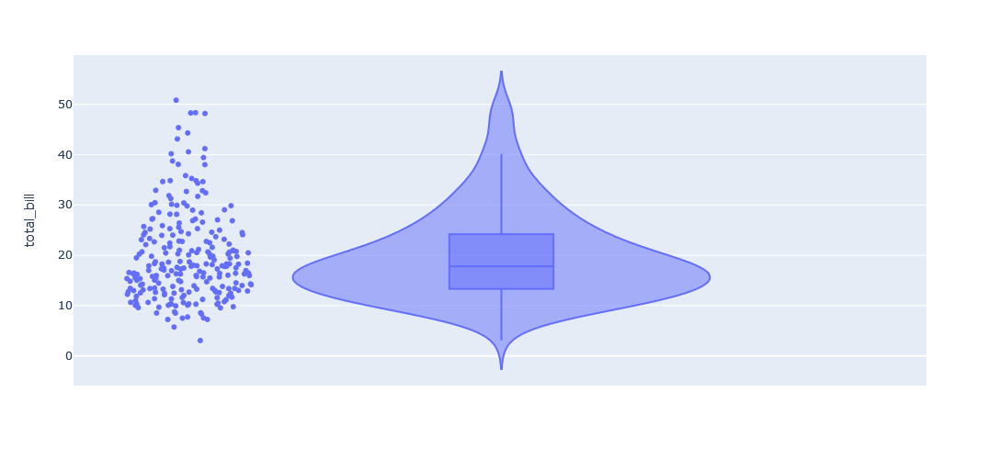

In [44]:
px.violin(df_tips, y="total_bill", box=True, points="all", height=500)

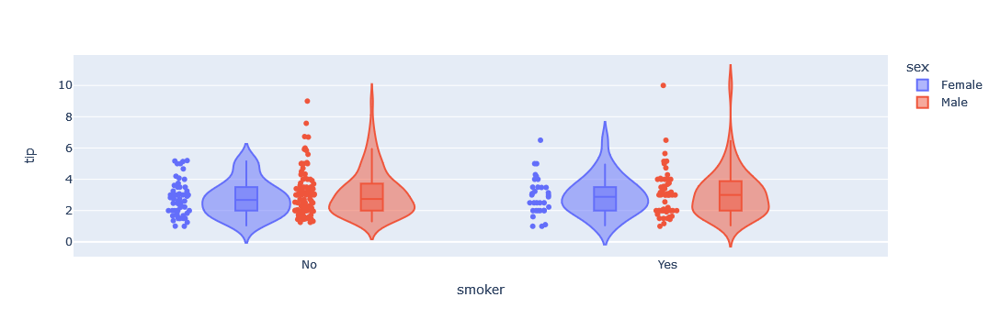

In [45]:
px.violin(df_tips, y="tip", x="smoker", color="sex", box=True, points="all", 
          hover_data=df_tips.columns
)

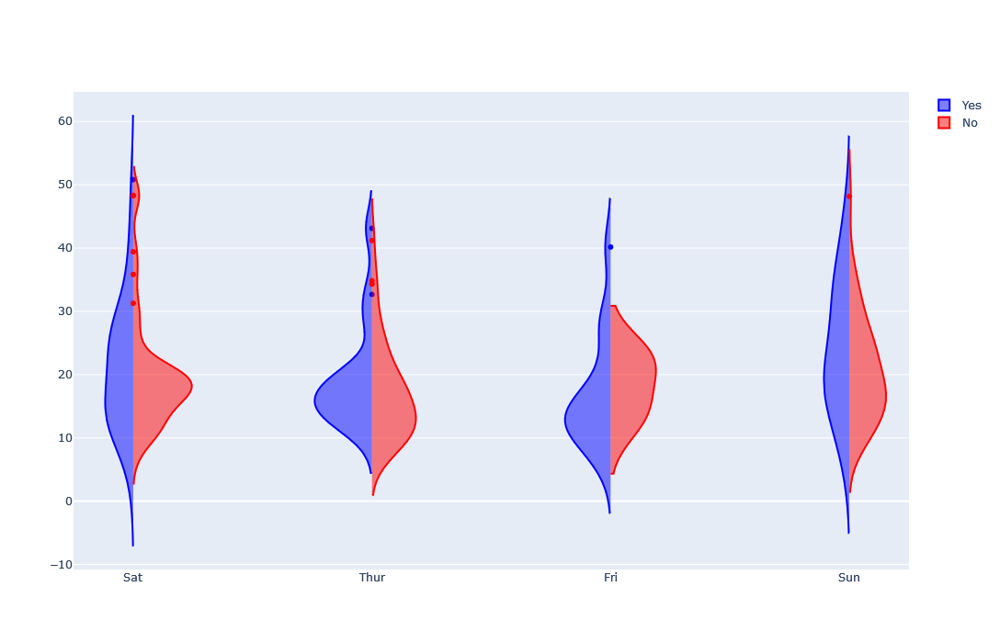

In [55]:
fig = go.Figure()

# left side of the violin plot
fig.add_trace(
    go.Violin(
        x = df_tips[df_tips["smoker"] == "Yes"]["day"],
        y = df_tips[df_tips["smoker"] == "Yes"]["total_bill"],
        legendgroup = "Yes",
        scalegroup = "Yes",
        name = "Yes",
        side = "negative",
        line_color = "blue"
    )
)

# right side of the violin plot
fig.add_trace(
    go.Violin(
        x = df_tips["day"][df_tips["smoker"] == "No"],
        y = df_tips["total_bill"][df_tips["smoker"] == "No"],
        legendgroup = "Yes",
        scalegroup = "Yes",
        name = "No",
        side = "positive",
        line_color = "red"
    )
)

fig.update_layout(
    autosize = False,
    height  = 700,
    width  =900
)

## Density Heatmaps

In [56]:
# load a new data
flights = sns.load_dataset("flights")
flights.head()

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121


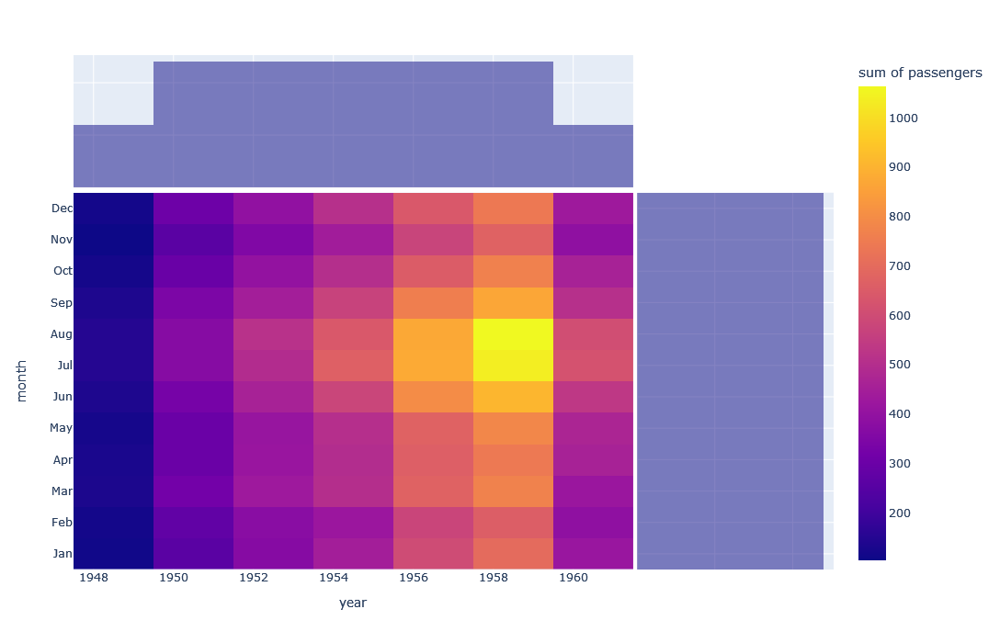

In [61]:
fig = px.density_heatmap(flights, x="year", y="month", z="passengers", height=700,
                        # also display the histogram
                        marginal_x = "histogram", marginal_y = "histogram"
)
fig

## 3D Scatter Plot

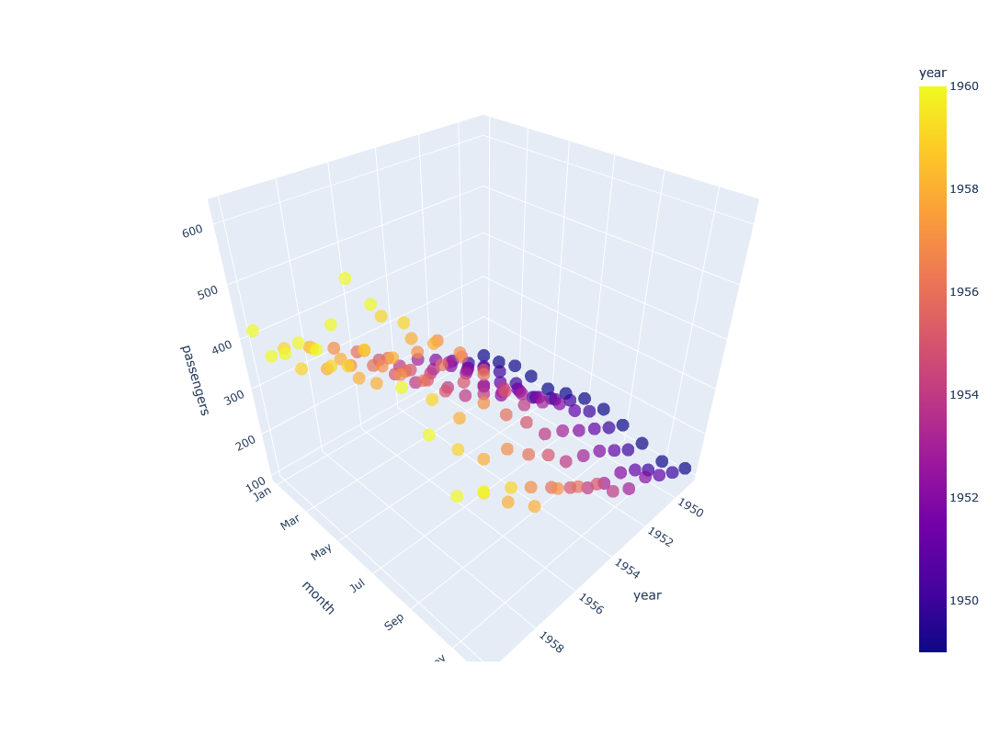

In [63]:
fig = px.scatter_3d(flights, x="year", y="month", z="passengers",
                   color="year", opacity=0.7, height = 800, width = 800)
fig

## 3D Line Plot

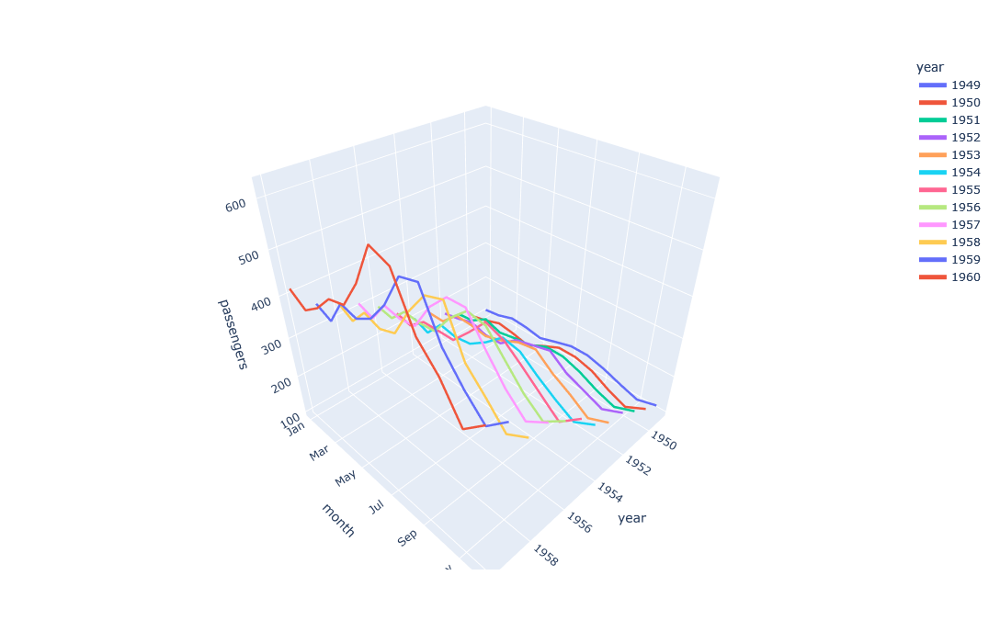

In [71]:
fig = px.line_3d(flights, x="year", y="month", z="passengers", color="year", height=700, width=700)

fig.update_traces(
    line = dict(width = 5)
)

## Scatter Matrix

c:\python\python38\lib\site-packages\plotly\express\_core.py:279: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



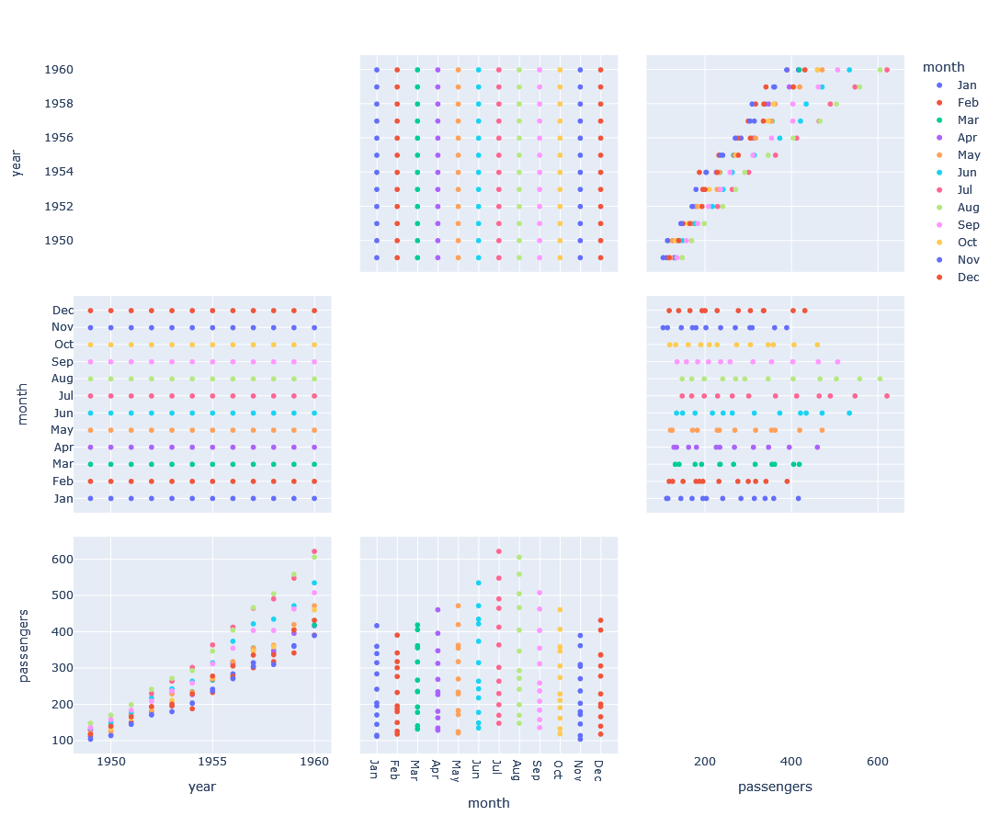

In [74]:
fig = px.scatter_matrix(flights, color="month", height=900)

fig.update_traces(diagonal_visible=False)

## Map Scatter Plot

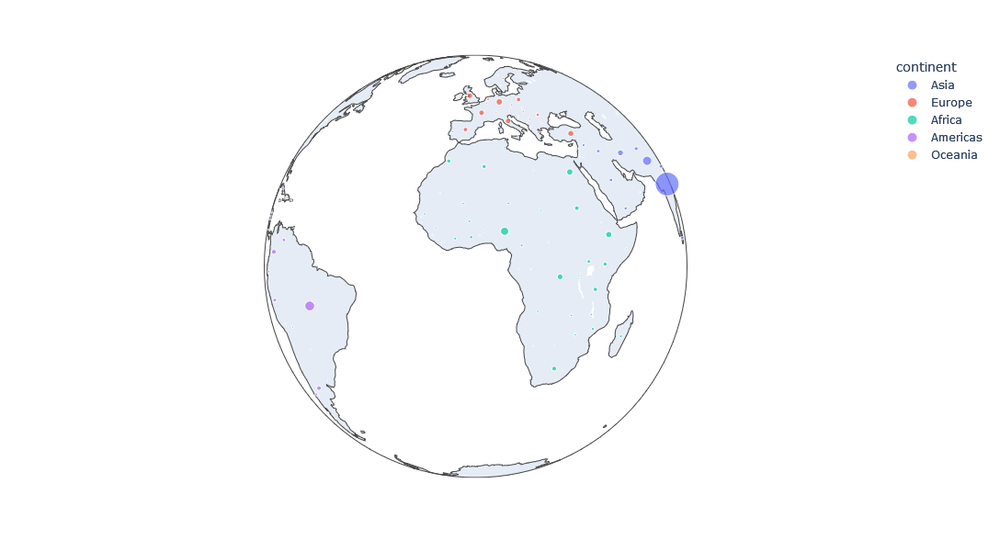

In [78]:
gapminder = px.data.gapminder().query("year == 2007")

fig = px.scatter_geo(gapminder, locations="iso_alpha", color="continent",
                    hover_name="country", size="pop", projection="orthographic",
                    width=600, height=600)
fig

## Choropleth Maps

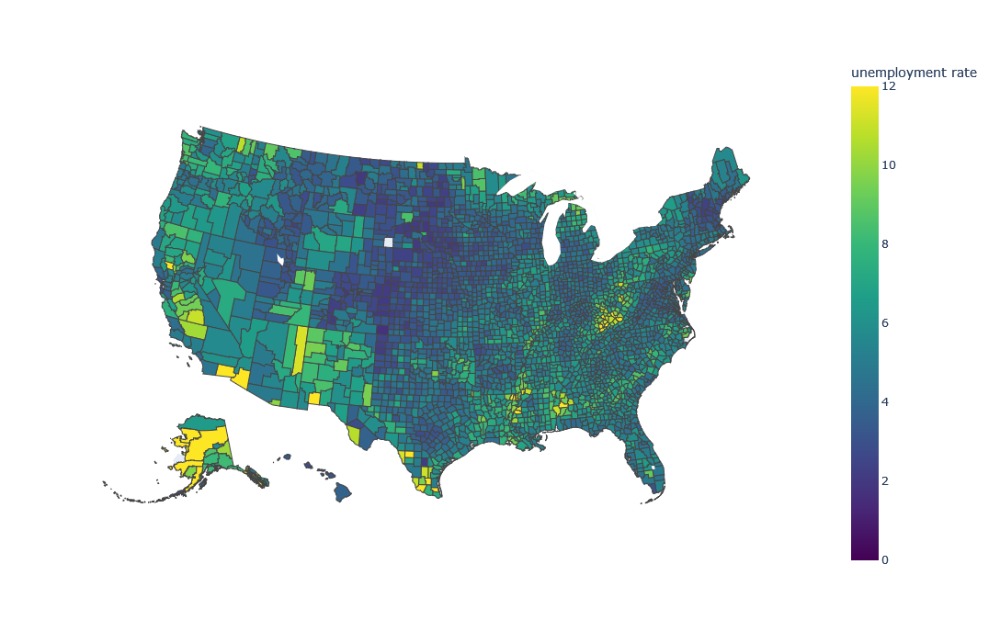

In [86]:
with urlopen("https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json") as response:
    counties = json.load(response)
    
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv", dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'},
                    width = 900,
                    height = 700
                          )
fig

## Polar Charts

In [89]:
# get the wind dataset
df_wind = px.data.wind()
df_wind.head()

,direction,strength,frequency
0,N,0-1,0.5
1,NNE,0-1,0.6
2,NE,0-1,0.5
3,ENE,0-1,0.4
4,E,0-1,0.4


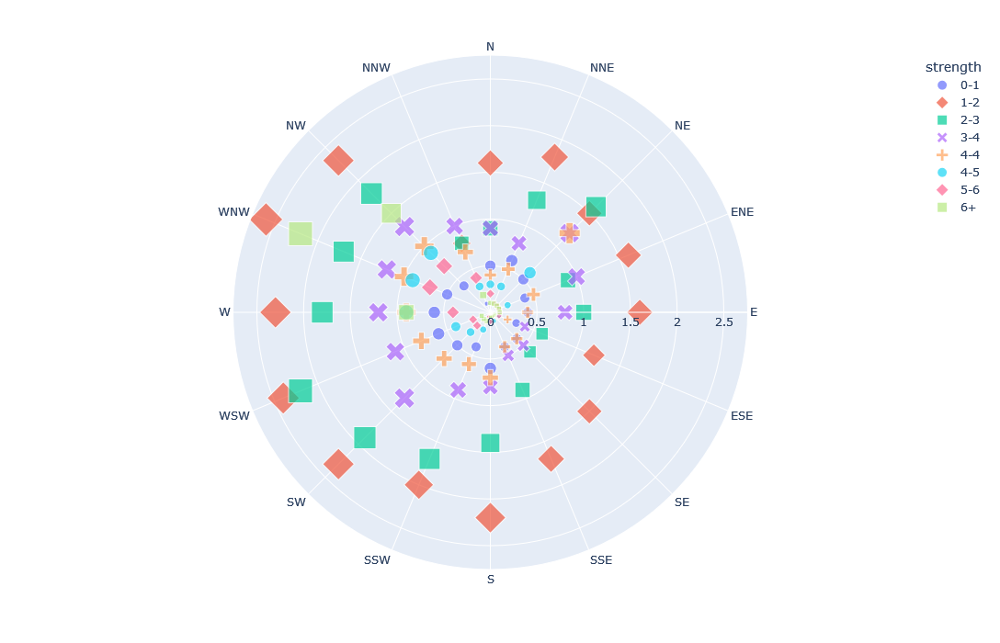

In [90]:
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength", 
                 size="frequency", symbol="strength", width=700, height=700)

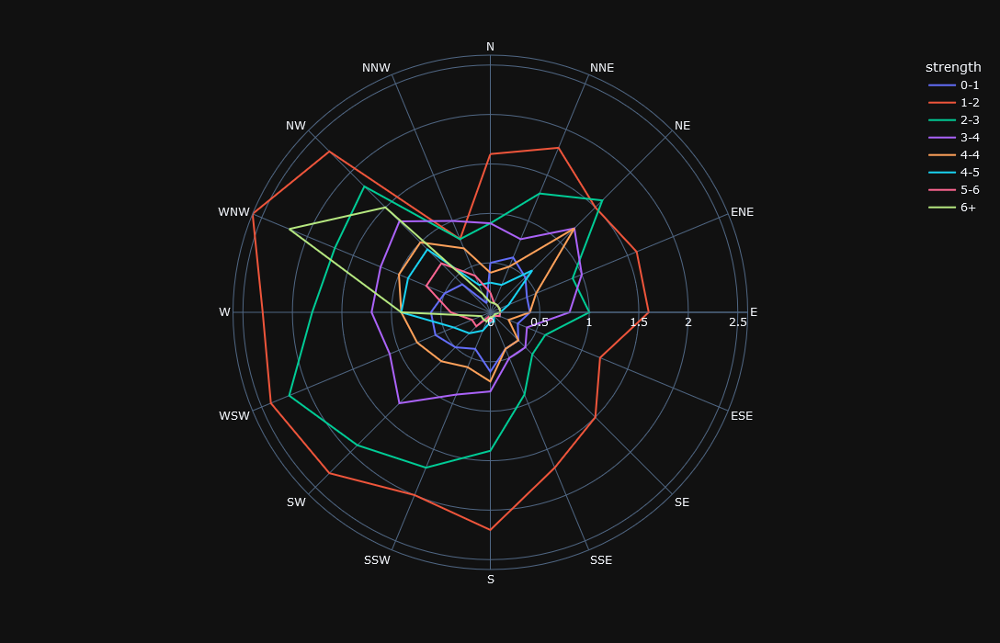

In [96]:
px.line_polar(df_wind, r="frequency", theta="direction", color="strength",
                 line_close=True, template="plotly_dark", width=700, height=700)

## Ternary Plots

In [97]:
# load experiment data
df_exp = px.data.experiment()
df_exp.head()

,experiment_1,experiment_2,experiment_3,gender,group
0,96.876065,93.417942,73.033193,male,control
1,87.301336,129.603395,66.056554,female,control
2,97.691312,106.187916,103.422709,male,treatment
3,102.978152,93.814682,56.995870,female,treatment
4,87.106993,107.019985,72.140292,male,control


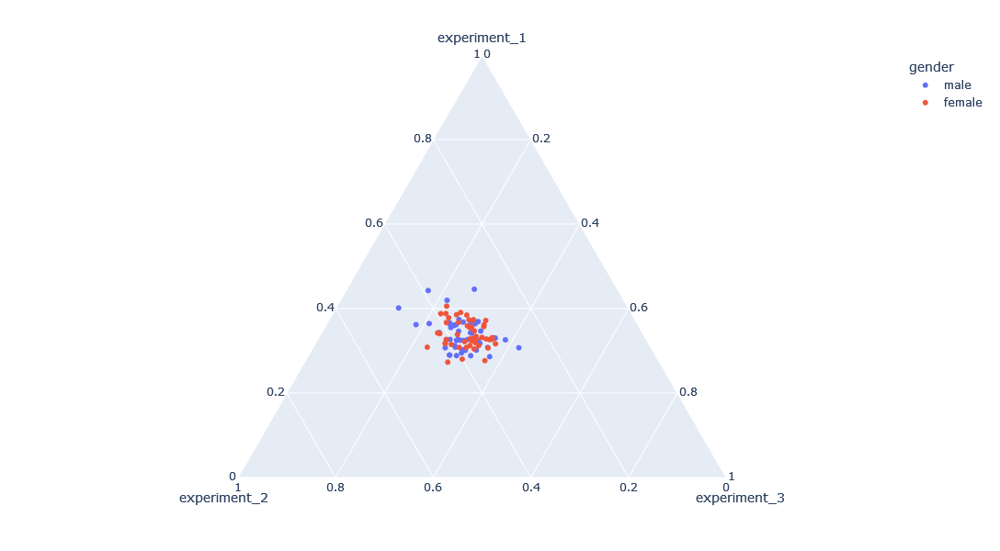

In [99]:
px.scatter_ternary(df_exp, a="experiment_1", b="experiment_2", c="experiment_3",
                  hover_name="group", color="gender", height=600)

## Facet Plots

In [100]:
df_tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


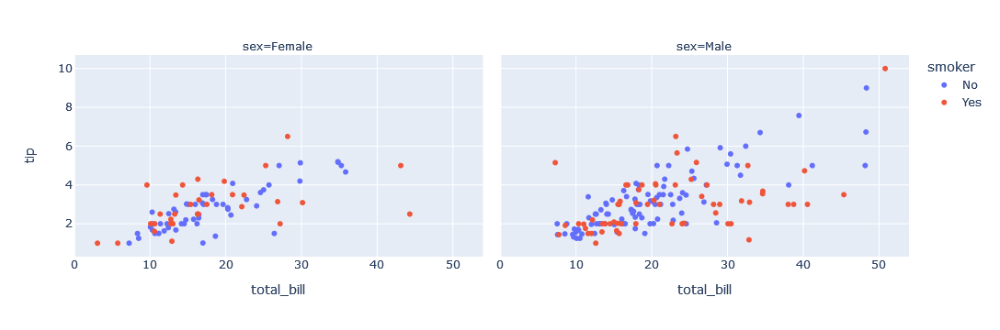

In [101]:
px.scatter(df_tips, x="total_bill", y="tip", color="smoker", facet_col="sex")

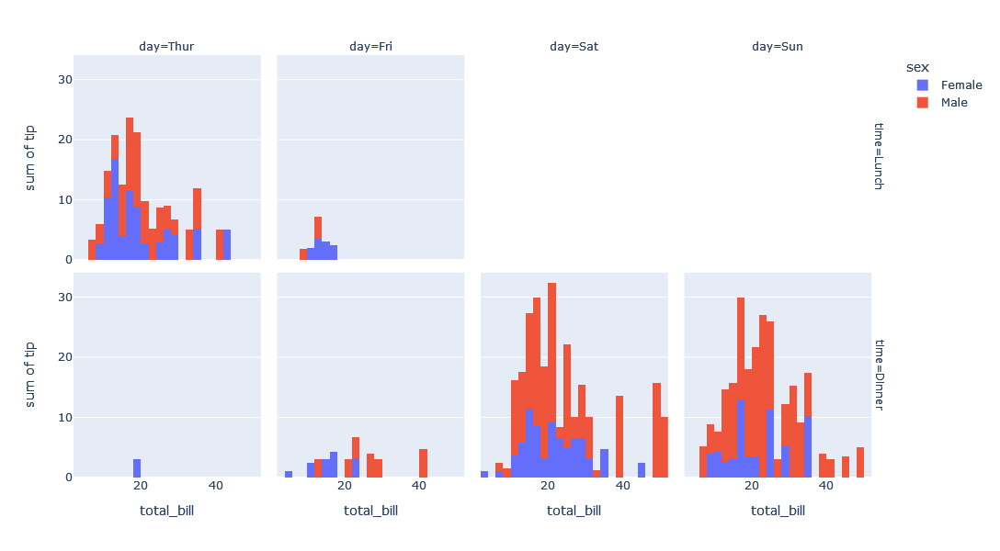

In [103]:
px.histogram(df_tips, x="total_bill", y="tip", color="sex", facet_row="time", facet_col="day",
            category_orders={"day": ["Thur", "Fri", "Sat", "Sun"], "time": ["Lunch", "Dinner"]},
            height=600)

In [104]:
att_df = sns.load_dataset("attention")
att_df.head()

,Unnamed: 0,subject,attention,solutions,score
0,0,1,divided,1,2.0
1,1,2,divided,1,3.0
2,2,3,divided,1,3.0
3,3,4,divided,1,5.0
4,4,5,divided,1,4.0


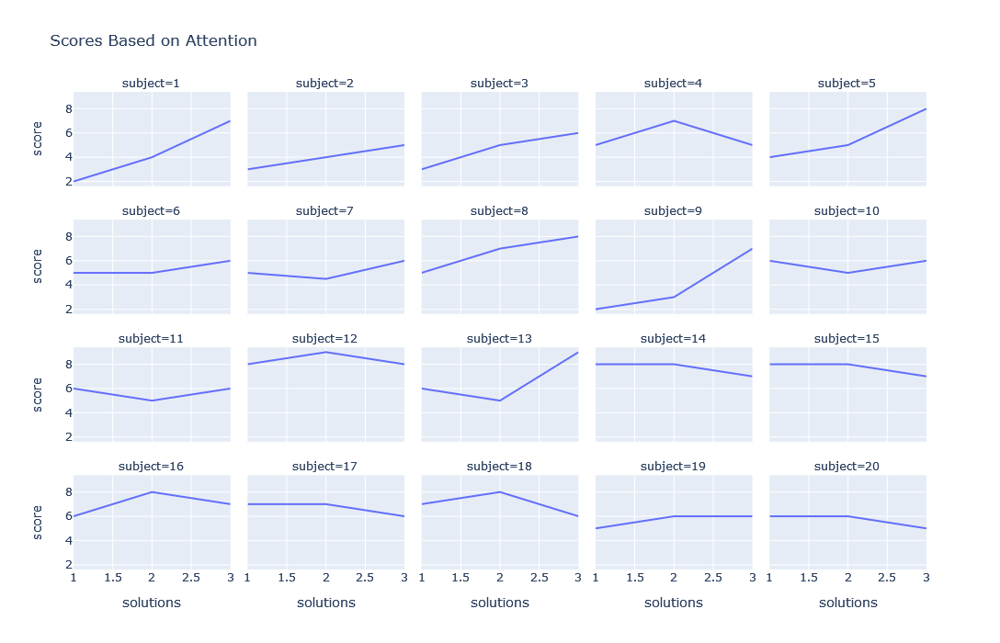

In [106]:
fig = px.line(att_df, x="solutions", y="score", facet_col="subject",
             facet_col_wrap=5, title="Scores Based on Attention", height=700)
fig

## Animated Plots

In [107]:
gapminder.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
11,Afghanistan,Asia,2007,43.828,31889923,974.580338,AFG,4
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
35,Algeria,Africa,2007,72.301,33333216,6223.367465,DZA,12
47,Angola,Africa,2007,42.731,12420476,4797.231267,AGO,24
59,Argentina,Americas,2007,75.320,40301927,12779.379640,ARG,32


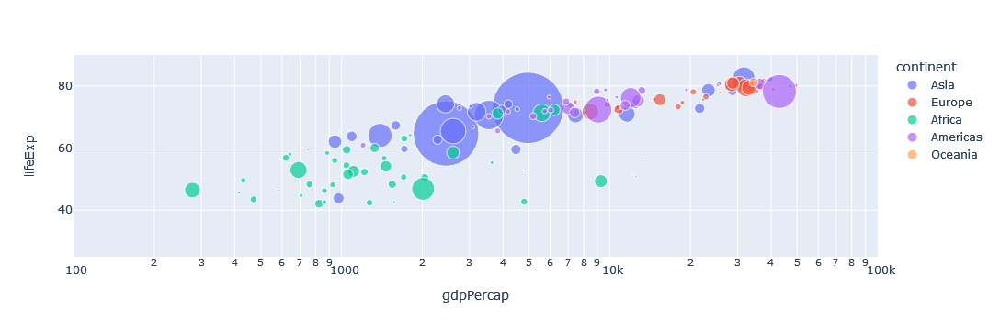

In [109]:
# look through other notebook

px.scatter(gapminder, x="gdpPercap", y="lifeExp", animation_frame="year",
          animation_group="country", size="pop", color="continent", hover_name="country",
          log_x=True, size_max=55, range_x=[100, 100_000], range_y=[25, 90])